<a href="https://colab.research.google.com/github/Putusutha/Enhancing_Image/blob/main/IPutuSuthaSatyawan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Nama : I Putu Sutha Satyawan**

**NIM : 2370231025**

## 🚀 Inisialisasi Proyek & Persiapan Environtment




Sebelum memulai eksplorasi dan pemrosesan citra digital, kita perlu melakukan beberapa langkah awal yang penting diantaranya:

🔗 Menghubungkan Google Drive
Supaya kita bisa mengakses file dataset atau gambar yang disimpan di Drive kita langsung dari Google Colab.

📦 Mengimpor Library Penting
Kita akan menggunakan beberapa pustaka (library) populer seperti:


*   OpenCV untuk membaca dan memproses gambar
*   NumPy untuk operasi numerik
* Matplotlib untuk visualisasi
* scikit-image untuk manipulasi citra lanjut (misalnya penyesuaian kontras)
*serta os dan sys untuk keperluan sistem file




🖼️ Mengatur Tampilan Visualisasi
Supaya gambar yang ditampilkan lebih besar dan nyaman dilihat.

In [15]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Import library yang dibutuhkan
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
import sys
from google.colab import drive
from pathlib import Path
import os
import urllib.request

# Konfigurasi untuk visualisasi
plt.rcParams['figure.figsize'] = (12, 8)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## 🗂️ Menentukan Lokasi Gambar & Mengambil Daftar File



Pada langkah ini, kita akan melakukan konfigurasi awal untuk menentukan folder gambar yang akan digunakan dalam proses pemrosesan gambar.

Langkah-langkah:
1. Menentukan Path Folder di Google Drive
Pastikan path yang digunakan mengarah ke folder di Google Drive yang sudah di-mount ke Google Colab. Link gdrive fotonya: https://drive.google.com/drive/folders/12KVS5h0QQBkXPRVCWnK_r4_85niavR1C?usp=drive_link

2. Validasi Folder dan Pengambilan File Gambar
Kode akan memeriksa:


*   Apakah folder tersebut benar-benar ada.
*   Apakah di dalam folder terdapat file dengan ekstensi gambar yang valid seperti .jpg, .jpeg, .png, .bmp, atau .tiff.

3. Mendefinisikan dan Menyimpan File Gambar
Hanya file dengan ekstensi yang sesuai yang akan diambil.

**Maksimal 3 gambar pertama yang akan digunakan.**
Nama-nama file gambar yang ditemukan akan ditampilkan sebagai konfirmasi.

In [16]:
drive_root = Path('/content/drive/MyDrive')
image_folder = None

for path in drive_root.glob('**/Enhance_Image'):
    if path.is_dir():
        image_folder = str(path)
        break

image_files = []
valid_extensions = ['.jpg', '.jpeg', '.png', '.bmp', '.tiff']

def is_valid_image(filename):
    return os.path.splitext(filename)[1].lower() in valid_extensions

# --- 3. Cek isi folder jika ditemukan ---
if image_folder:
    print(f"[Google Drive] Folder ditemukan: {image_folder}")

    for filename in os.listdir(image_folder):
        full_path = os.path.join(image_folder, filename)
        if os.path.isfile(full_path) and is_valid_image(filename):
            image_files.append(full_path)
            if len(image_files) >= 3:
                break

    if image_files:
        print(f"[Google Drive] Ditemukan {len(image_files)} file gambar:")
        for img_file in image_files:
            print(f"- {os.path.basename(img_file)}")
    else:
        print("[Google Drive] Folder ditemukan, tapi tidak ada gambar valid.")
else:
    print("[Google Drive] Folder Enhance_Image tidak ditemukan.")

# --- 4. Jika tidak ada gambar, fallback ke GitHub ---
if not image_files:
    print("[Fallback] Mengambil gambar dari GitHub...")

    github_image_urls = [
        "https://raw.githubusercontent.com/username/repo/main/images/image1.jpg",
        "https://raw.githubusercontent.com/username/repo/main/images/image2.jpg",
        "https://raw.githubusercontent.com/username/repo/main/images/image3.jpg"
    ]

    os.makedirs("github_images", exist_ok=True)
    for url in github_image_urls:
        filename = os.path.basename(url)
        local_path = os.path.join("github_images", filename)
        try:
            urllib.request.urlretrieve(url, local_path)
            image_files.append(local_path)
        except Exception as e:
            print(f"Gagal unduh {url}: {e}")

    if image_files:
        print(f"[GitHub] Berhasil ambil {len(image_files)} gambar:")
        for img in image_files:
            print(f"- {img}")
    else:
        print("[Fallback] Gagal menemukan gambar dari GitHub juga.")

Folder ditemukan: /content/drive/MyDrive/Enhance_Image
Ditemukan 3 file gambar:
- WhatsApp Image 2025-04-18 at 15.04.31.jpeg
- WhatsApp Image 2025-04-18 at 15.10.19.jpeg
- WhatsApp Image 2025-04-18 at 15.22.03.jpeg


## 📊 Visualisasi Histogram RGB Original



Sebelum memanipulasi atau meningkatkan kualitas gambar, penting untuk memahami distribusi intensitas warna dalam citra. Hal ini membantu untuk mengetahui apakah gambar:

*  Terlalu gelap 🌑
*  Terlalu terang 🌕

*  Atau memiliki kontras rendah (berkabut)

🎨 Pada bagian ini, kita akan:

Membaca setiap gambar satu per satu

Menampilkan histogram RGB untuk masing-masing channel warna:

🔴 Merah (R)

🟢 Hijau (G)

🔵 Biru (B)

📈 Histogram menunjukkan:

Sumbu X: Nilai piksel (0–255)

Sumbu Y: Jumlah piksel untuk setiap nilai

Dari histogram ini, kita bisa mengetahui seberapa tersebar intensitas warna dalam gambar dan apakah perlu dilakukan equalization atau teknik peningkatan kualitas lainnya.


Menampilkan histogram dari: WhatsApp Image 2025-04-18 at 15.04.31.jpeg


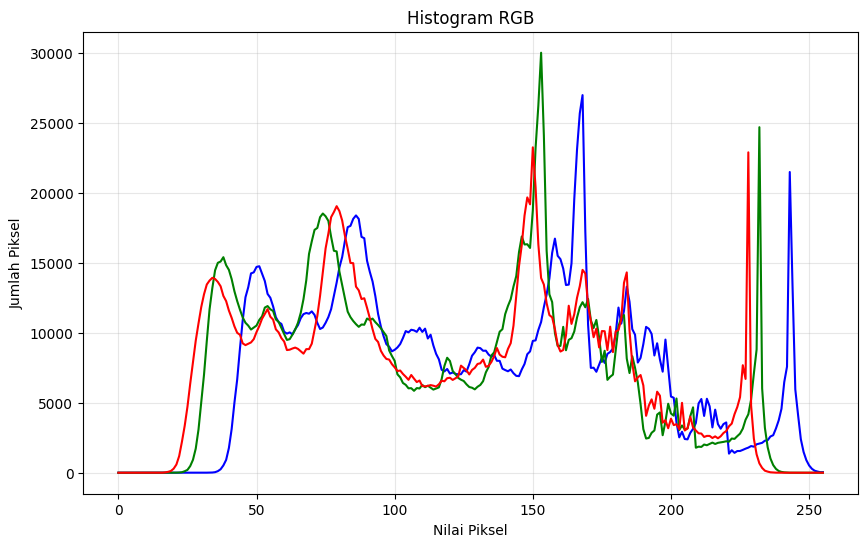


Menampilkan histogram dari: WhatsApp Image 2025-04-18 at 15.10.19.jpeg


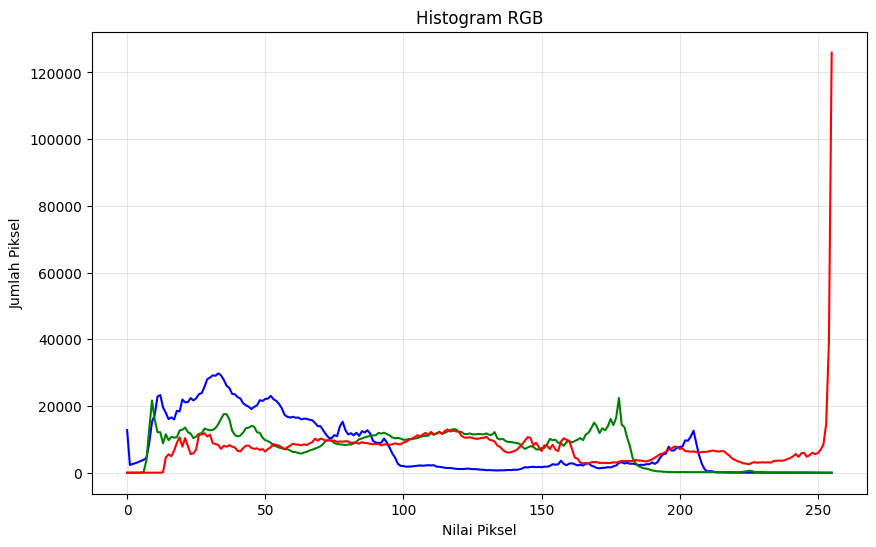


Menampilkan histogram dari: WhatsApp Image 2025-04-18 at 15.22.03.jpeg


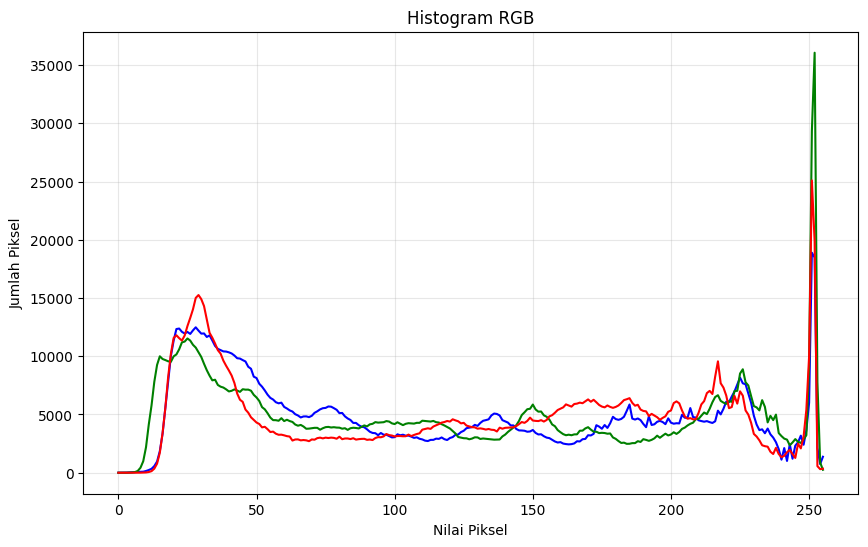

In [4]:
for img_path in image_files:
    print(f"\nMenampilkan histogram dari: {os.path.basename(img_path)}")
    img = cv2.imread(img_path)

    # Tampilkan histogram RGB
    colors = ('b', 'g', 'r')
    plt.figure(figsize=(10, 6))
    for i, color in enumerate(colors):
        hist = cv2.calcHist([img], [i], None, [256], [0, 256])
        plt.plot(hist, color=color)
    plt.title('Histogram RGB')
    plt.xlabel('Nilai Piksel')
    plt.ylabel('Jumlah Piksel')
    plt.grid(alpha=0.3)
    plt.show()

## 🧪 Equalisasi Histogram RGB Naive

---



Pada tahap ini, saya melakukan equalisasi histogram secara naif pada gambar berwarna. Artinya, setiap channel warna (Red, Green, Blue) akan di-equalize secara terpisah dan independen.

🔍 Langkah-langkah yang dilakukan:

1. Membaca gambar dari folder yang sudah ditentukan.

2. Mengonversi citra ke format RGB agar bisa ditampilkan dengan matplotlib.

3. Melakukan histogram equalization pada masing-masing channel (R, G, B).

4. Menggabungkan kembali ketiga channel hasil equalisasi menjadi satu citra.

5. Menampilkan perbandingan antara gambar asli dan hasil equalization


🔍 Menampilkan hasil equalization dan histogram untuk: WhatsApp Image 2025-04-18 at 15.04.31.jpeg


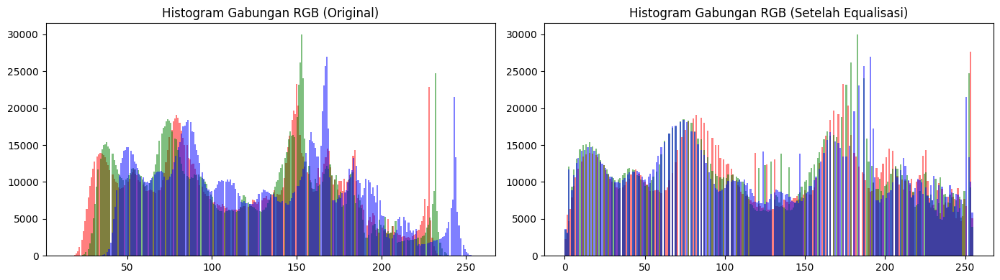

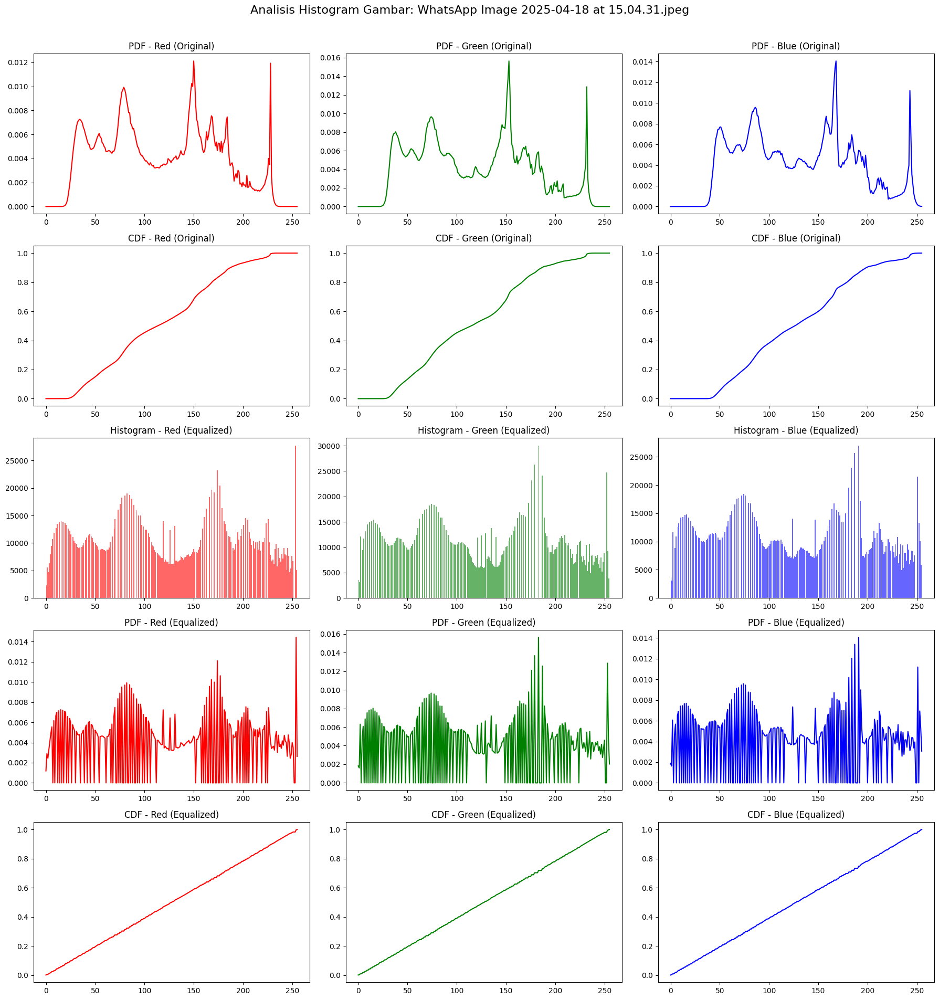

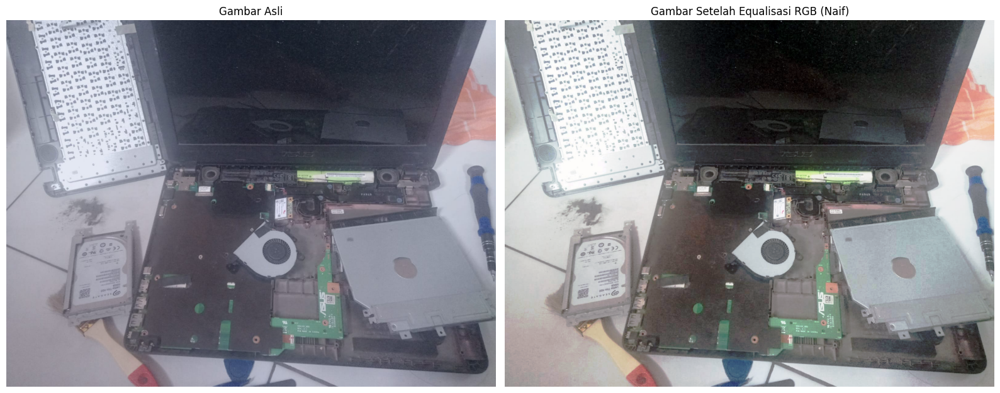


🔍 Menampilkan hasil equalization dan histogram untuk: WhatsApp Image 2025-04-18 at 15.10.19.jpeg


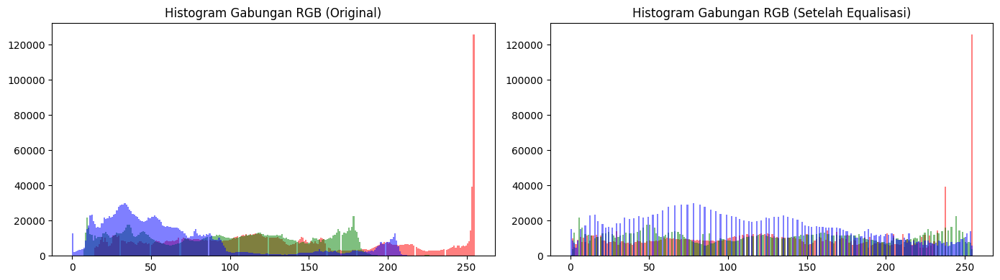

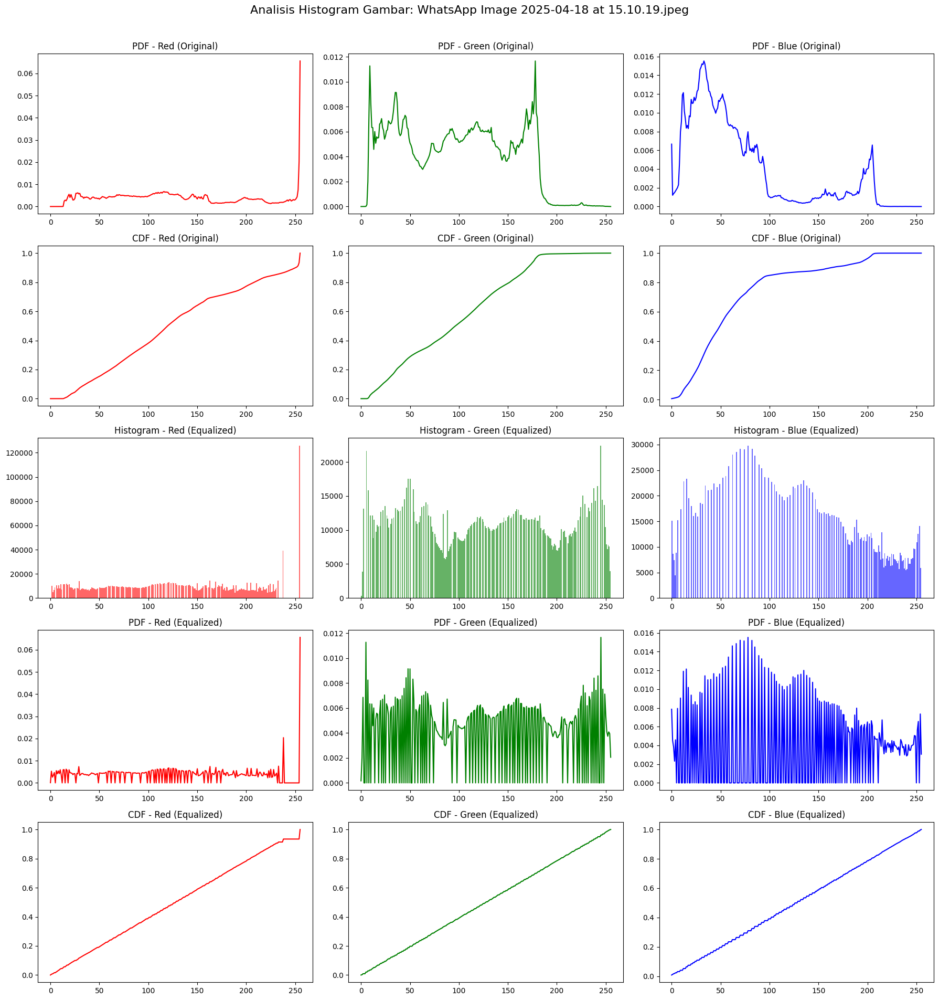

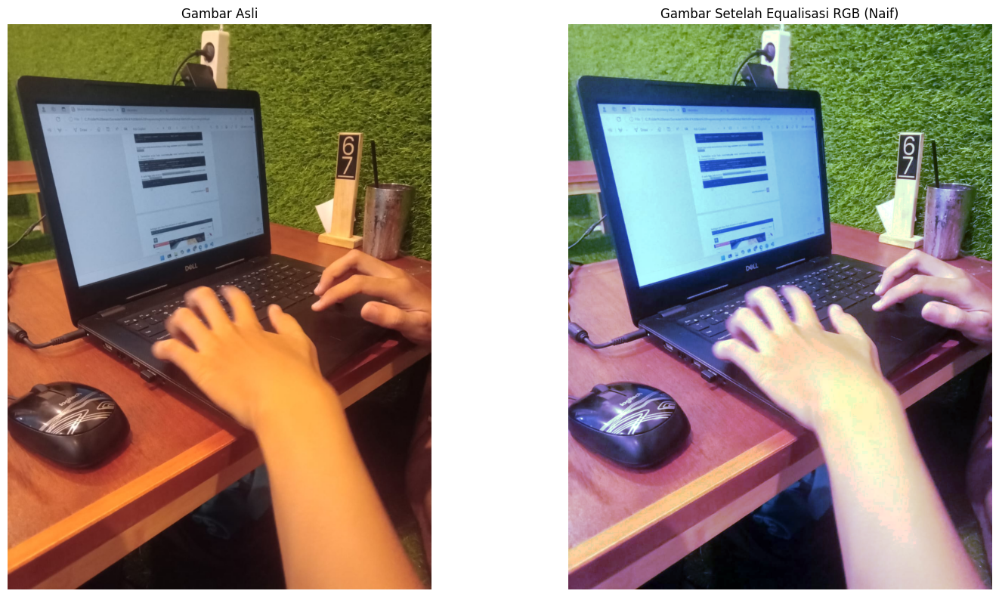


🔍 Menampilkan hasil equalization dan histogram untuk: WhatsApp Image 2025-04-18 at 15.22.03.jpeg


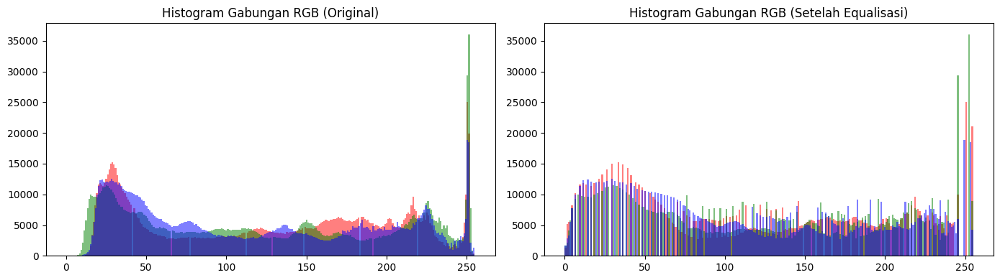

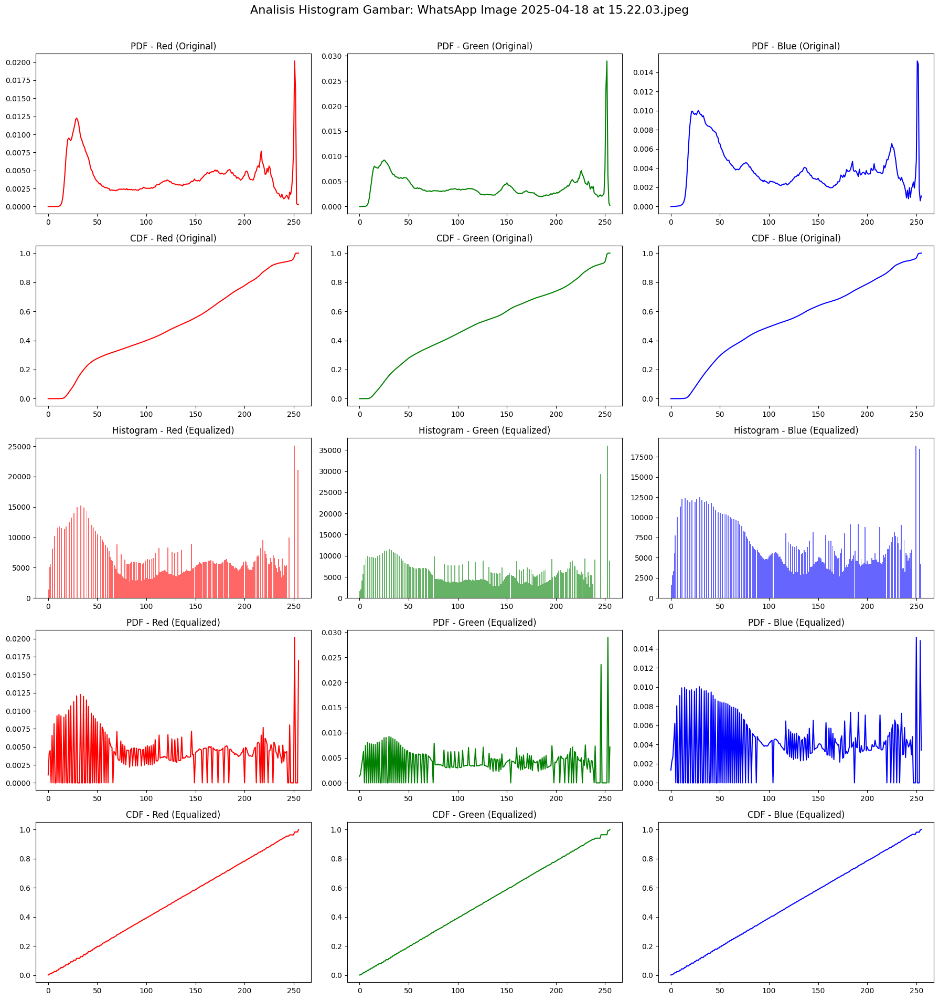

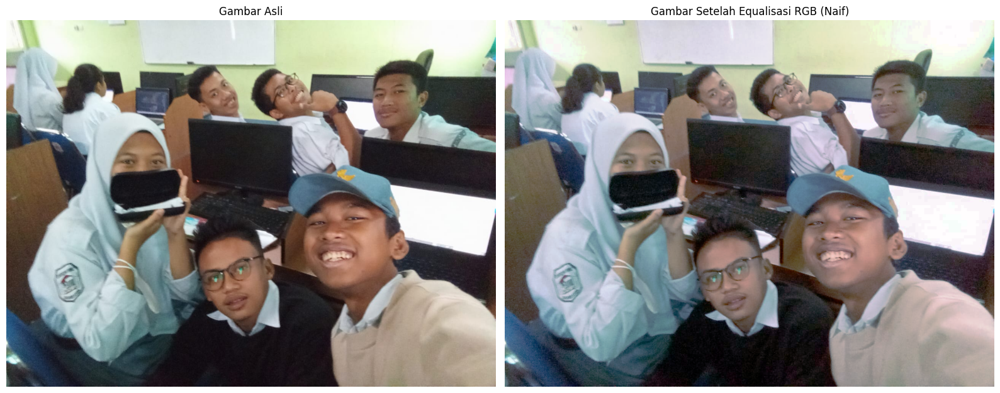

In [5]:
def calculate_pdf_cdf(channel):
    """Menghitung PDF dan CDF dari channel gambar grayscale."""
    hist, bins = np.histogram(channel.flatten(), 256, [0, 256])
    pdf = hist / np.sum(hist)
    cdf = np.cumsum(pdf)
    return pdf, cdf

for idx, img_path in enumerate(image_files):
    print(f"\n🔍 Menampilkan hasil equalization dan histogram untuk: {os.path.basename(img_path)}")
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Split channel
    b, g, r = cv2.split(img)

    # Equalize each channel
    b_eq = cv2.equalizeHist(b)
    g_eq = cv2.equalizeHist(g)
    r_eq = cv2.equalizeHist(r)
    img_eq = cv2.merge([b_eq, g_eq, r_eq])
    img_eq_rgb = cv2.cvtColor(img_eq, cv2.COLOR_BGR2RGB)

    # Histogram gabungan sebelum dan sesudah
    fig0, axs0 = plt.subplots(1, 2, figsize=(14, 4))
    colors = ['r', 'g', 'b']
    channels = [r, g, b]
    eq_channels = [r_eq, g_eq, b_eq]

    for ch, color in zip(channels, colors):
        axs0[0].hist(ch.ravel(), bins=256, color=color, alpha=0.5)
    axs0[0].set_title("Histogram Gabungan RGB (Original)")

    for ch_eq, color in zip(eq_channels, colors):
        axs0[1].hist(ch_eq.ravel(), bins=256, color=color, alpha=0.5)
    axs0[1].set_title("Histogram Gabungan RGB (Setelah Equalisasi)")

    plt.tight_layout()
    plt.show()

    # PDF, CDF, Histogram channel-wise
    fig, axs = plt.subplots(5, 3, figsize=(18, 20))
    fig.suptitle(f"Analisis Histogram Gambar: {os.path.basename(img_path)}", fontsize=16)

    color_labels = ['Red', 'Green', 'Blue']

    for i, (ch_orig, ch_eq, color, label) in enumerate(zip(channels, eq_channels, colors, color_labels)):
        # PDF dan CDF sebelum equalization
        pdf_orig, cdf_orig = calculate_pdf_cdf(ch_orig)
        # PDF dan CDF setelah equalization
        pdf_eq, cdf_eq = calculate_pdf_cdf(ch_eq)

        # PDF original
        axs[0, i].plot(pdf_orig, color=color)
        axs[0, i].set_title(f"PDF - {label} (Original)")

        # CDF original
        axs[1, i].plot(cdf_orig, color=color)
        axs[1, i].set_title(f"CDF - {label} (Original)")

        # Histogram equalized
        axs[2, i].hist(ch_eq.ravel(), bins=256, color=color, alpha=0.6)
        axs[2, i].set_title(f"Histogram - {label} (Equalized)")

        # PDF equalized
        axs[3, i].plot(pdf_eq, color=color)
        axs[3, i].set_title(f"PDF - {label} (Equalized)")

        # CDF equalized
        axs[4, i].plot(cdf_eq, color=color)
        axs[4, i].set_title(f"CDF - {label} (Equalized)")

    plt.tight_layout(rect=[0, 0.03, 1, 0.97])
    plt.show()

    # Gambar asli dan hasil equalisasi
    fig2, axs2 = plt.subplots(1, 2, figsize=(16, 8))
    axs2[0].imshow(img_rgb)
    axs2[0].set_title("Gambar Asli")
    axs2[0].axis('off')

    axs2[1].imshow(img_eq_rgb)
    axs2[1].set_title("Gambar Setelah Equalisasi RGB (Naif)")
    axs2[1].axis('off')

    plt.tight_layout()
    plt.show()

## 🌈 Equalisasi Histogram pada Channel Value (HSV)


Metode ini menggunakan ruang warna HSV (Hue, Saturation, Value), yang lebih relevan secara persepsi visual manusia.

🛠️ Langkah-langkah:

1. Konversi gambar dari BGR ke HSV

2. Equalisasi hanya pada channel V

3. Gabungkan kembali channel HSV

4. Konversi ulang ke BGR agar bisa ditampilkan kembali

5. Bandingkan hasilnya secara visual


📸 Menampilkan hasil HSV Equalization untuk: WhatsApp Image 2025-04-18 at 15.04.31.jpeg


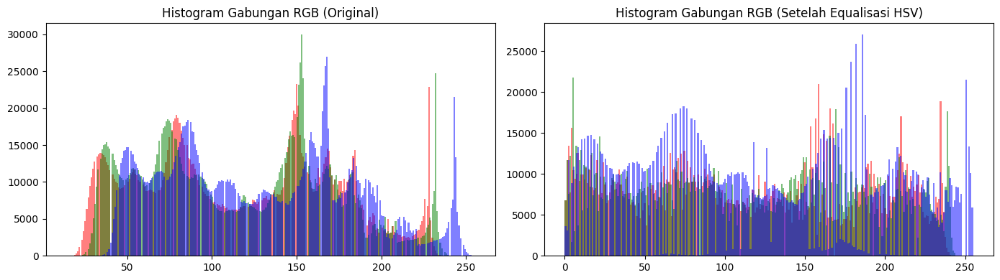

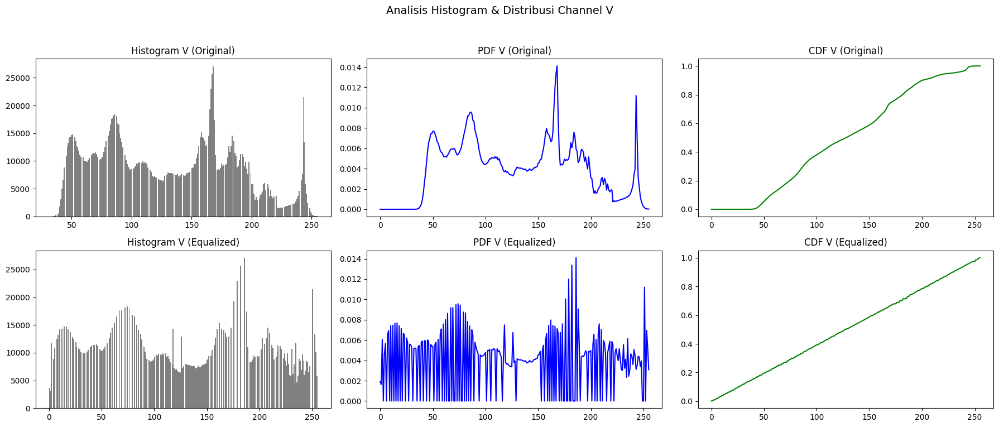

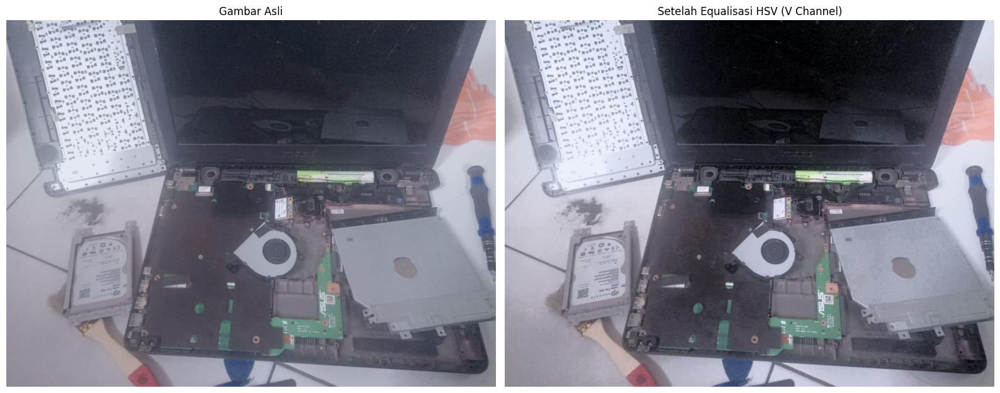


📸 Menampilkan hasil HSV Equalization untuk: WhatsApp Image 2025-04-18 at 15.10.19.jpeg


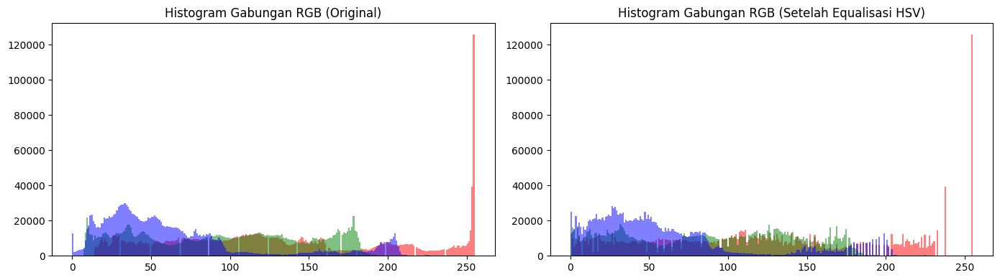

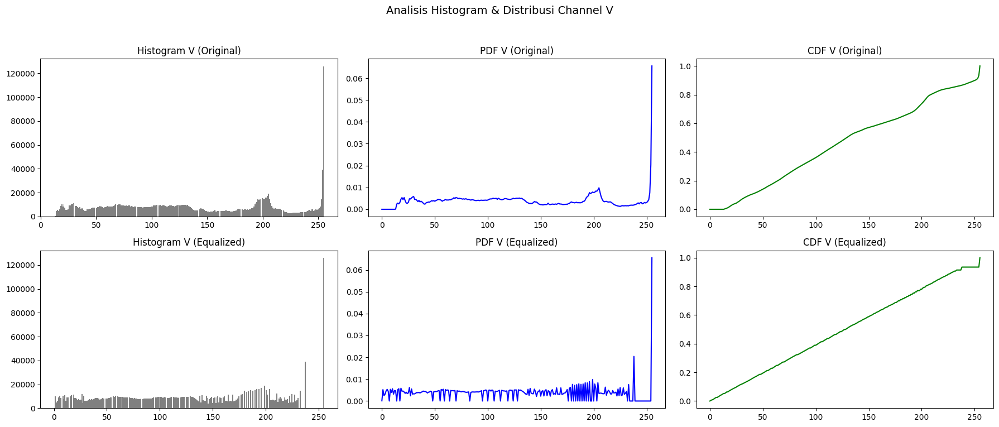

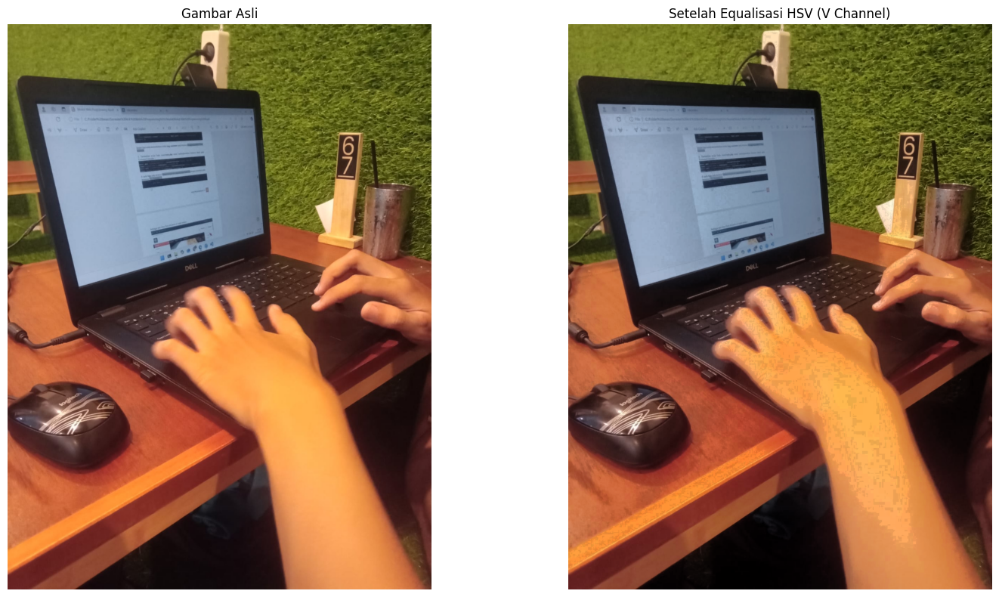


📸 Menampilkan hasil HSV Equalization untuk: WhatsApp Image 2025-04-18 at 15.22.03.jpeg


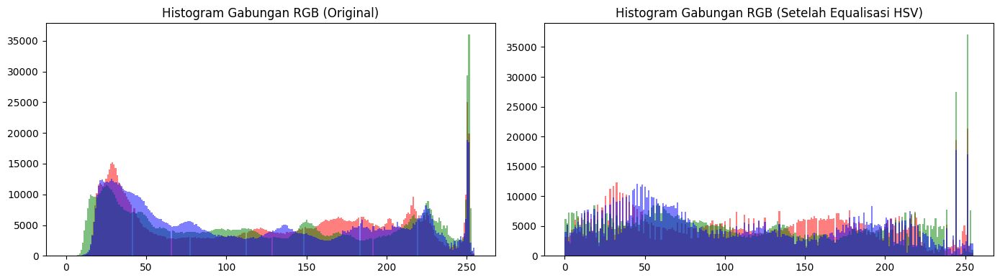

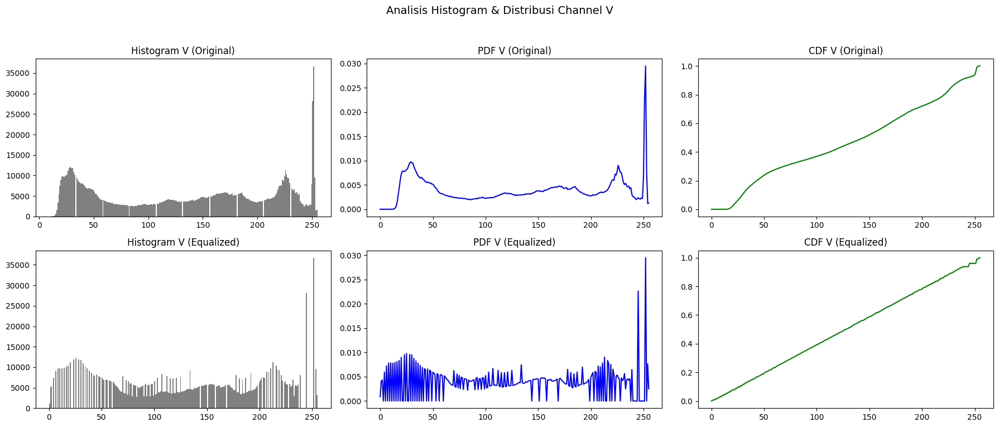

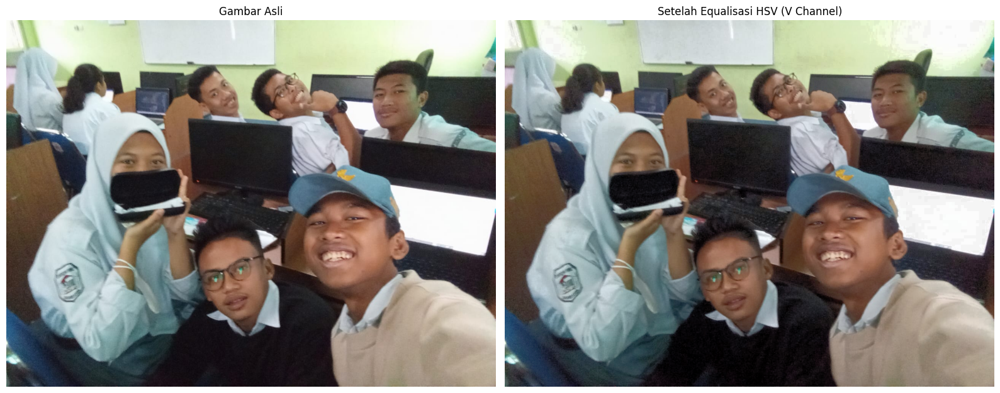

In [6]:
for idx, img_path in enumerate(image_files):
    print(f"\n📸 Menampilkan hasil HSV Equalization untuk: {os.path.basename(img_path)}")
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Convert to HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)

    # Simpan nilai asli V sebelum equalization
    v_orig = v.copy()

    # Equalize only V channel
    v_eq = cv2.equalizeHist(v)
    hsv_eq = cv2.merge([h, s, v_eq])
    img_eq = cv2.cvtColor(hsv_eq, cv2.COLOR_HSV2BGR)
    img_eq_rgb = cv2.cvtColor(img_eq, cv2.COLOR_BGR2RGB)

    # ======= Histogram Gabungan RGB (sebelum & sesudah) =======
    fig_rgb_hist, ax_rgb_hist = plt.subplots(1, 2, figsize=(14, 4))
    colors = ['r', 'g', 'b']
    ch_orig = cv2.split(img_rgb)
    ch_eq = cv2.split(img_eq_rgb)

    for ch, color in zip(ch_orig, colors):
        ax_rgb_hist[0].hist(ch.ravel(), bins=256, color=color, alpha=0.5)
    ax_rgb_hist[0].set_title("Histogram Gabungan RGB (Original)")

    for ch, color in zip(ch_eq, colors):
        ax_rgb_hist[1].hist(ch.ravel(), bins=256, color=color, alpha=0.5)
    ax_rgb_hist[1].set_title("Histogram Gabungan RGB (Setelah Equalisasi HSV)")

    plt.tight_layout()
    plt.show()

    # ======= Histogram, PDF, dan CDF Channel V =======
    pdf_orig, cdf_orig = calculate_pdf_cdf(v_orig)
    pdf_eq, cdf_eq = calculate_pdf_cdf(v_eq)

    fig_hist, axs_hist = plt.subplots(2, 3, figsize=(18, 8))
    fig_hist.suptitle("Analisis Histogram & Distribusi Channel V", fontsize=14)

    axs_hist[0, 0].hist(v_orig.ravel(), bins=256, color='gray')
    axs_hist[0, 0].set_title("Histogram V (Original)")

    axs_hist[0, 1].plot(pdf_orig, color='blue')
    axs_hist[0, 1].set_title("PDF V (Original)")

    axs_hist[0, 2].plot(cdf_orig, color='green')
    axs_hist[0, 2].set_title("CDF V (Original)")

    axs_hist[1, 0].hist(v_eq.ravel(), bins=256, color='gray')
    axs_hist[1, 0].set_title("Histogram V (Equalized)")

    axs_hist[1, 1].plot(pdf_eq, color='blue')
    axs_hist[1, 1].set_title("PDF V (Equalized)")

    axs_hist[1, 2].plot(cdf_eq, color='green')
    axs_hist[1, 2].set_title("CDF V (Equalized)")

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    # ======= Tampilan Gambar Asli & Equalized =======
    fig_img, axs_img = plt.subplots(1, 2, figsize=(16, 8))
    axs_img[0].imshow(img_rgb)
    axs_img[0].set_title("Gambar Asli")
    axs_img[0].axis('off')

    axs_img[1].imshow(img_eq_rgb)
    axs_img[1].set_title("Setelah Equalisasi HSV (V Channel)")
    axs_img[1].axis('off')

    plt.tight_layout()
    plt.show()

## 🎨 Equalisasi Histogram pada Channel Lightness (LAB)


Metode ini memanfaatkan ruang warna LAB, yang dirancang untuk menyerupai persepsi warna manusia.

🛠️ Langkah-langkah:
1. Konversi gambar dari BGR ke LAB
2. Equalisasi hanya pada channel L
3. Gabungkan kembali channel LAB
4. Konversi ulang ke BGR agar bisa ditampilkan kembali
5. Bandingkan hasilnya secara visual












🎨 Menampilkan hasil LAB Equalization untuk: WhatsApp Image 2025-04-18 at 15.04.31.jpeg


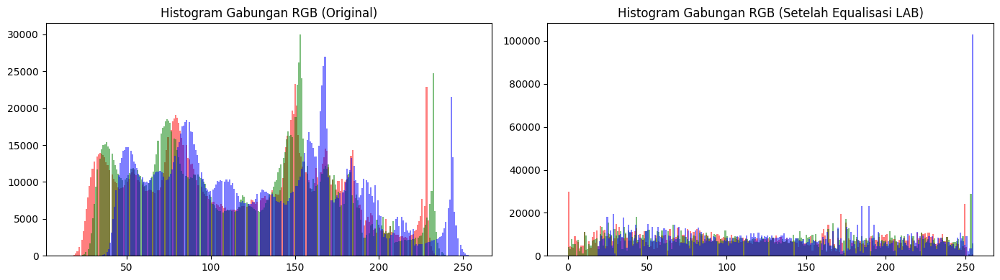

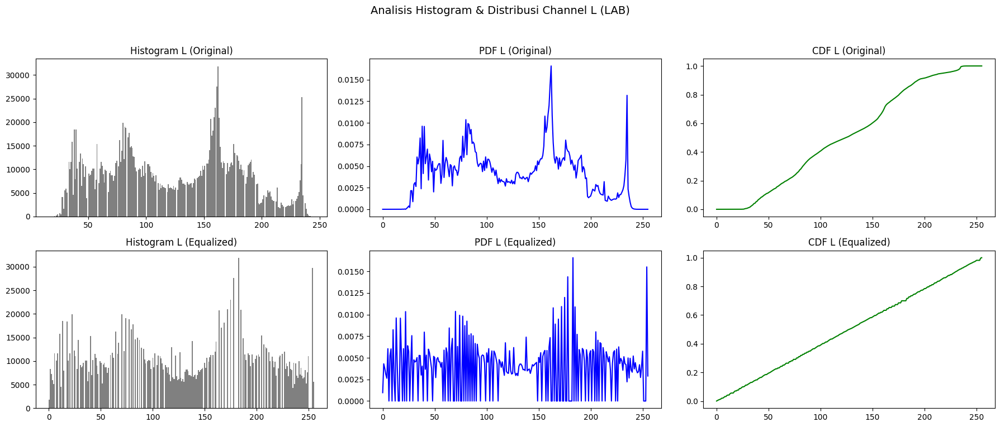

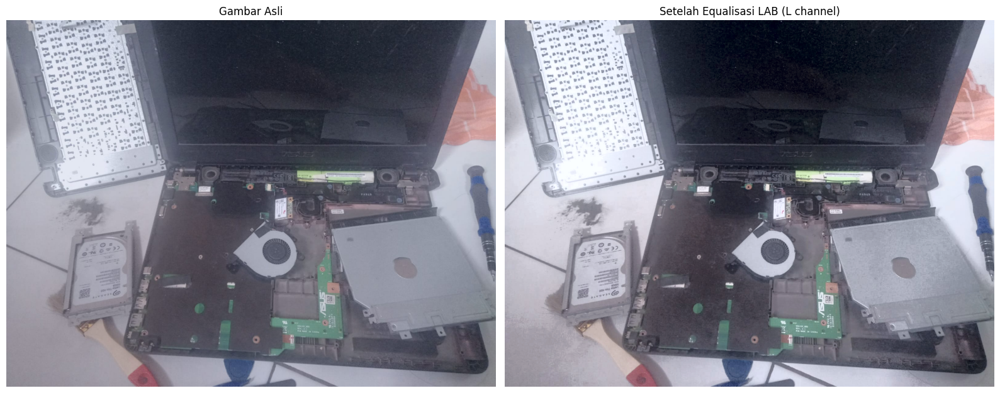


🎨 Menampilkan hasil LAB Equalization untuk: WhatsApp Image 2025-04-18 at 15.10.19.jpeg


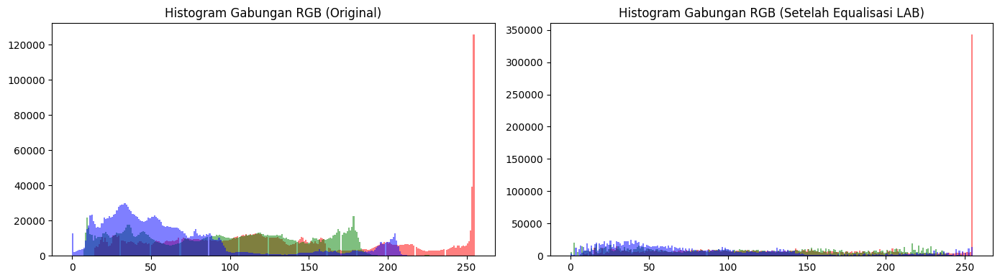

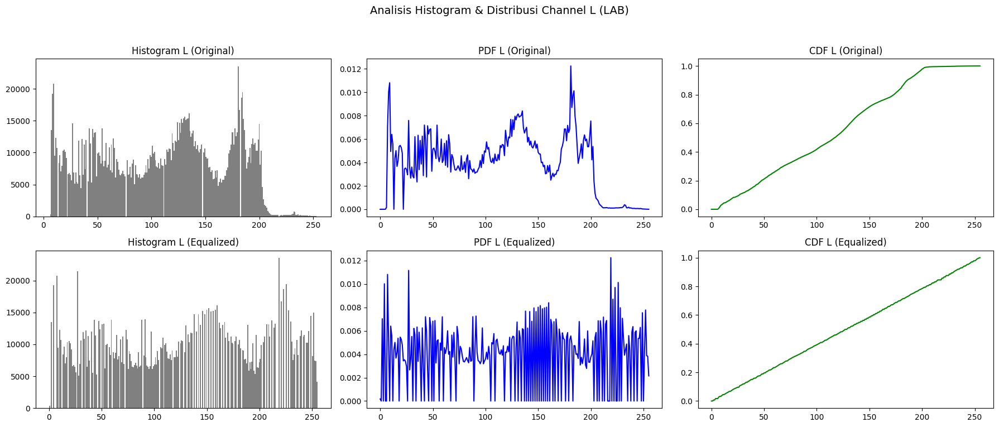

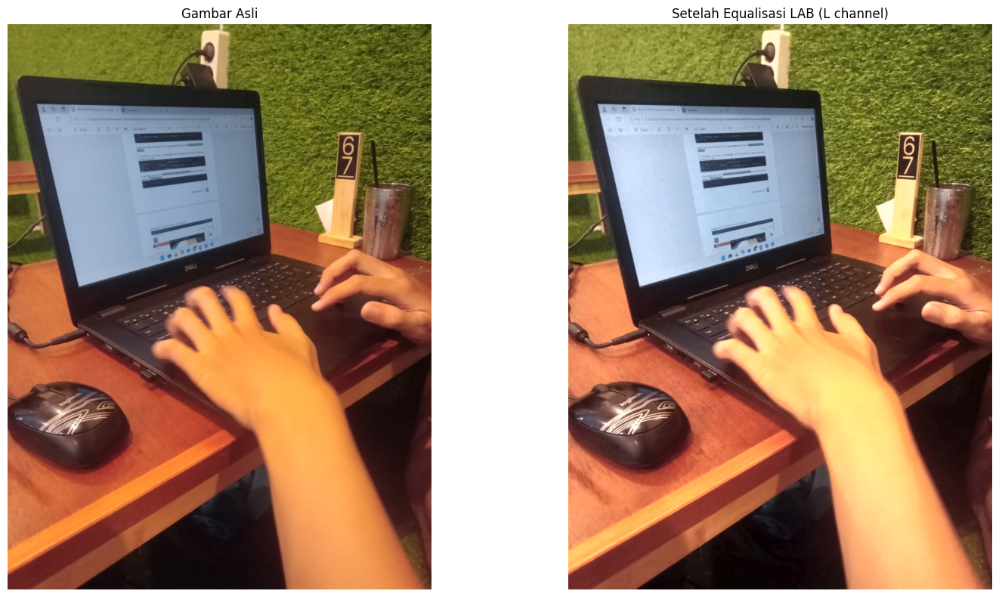


🎨 Menampilkan hasil LAB Equalization untuk: WhatsApp Image 2025-04-18 at 15.22.03.jpeg


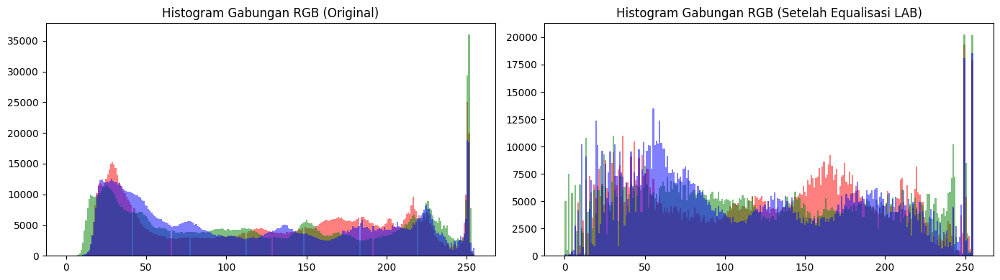

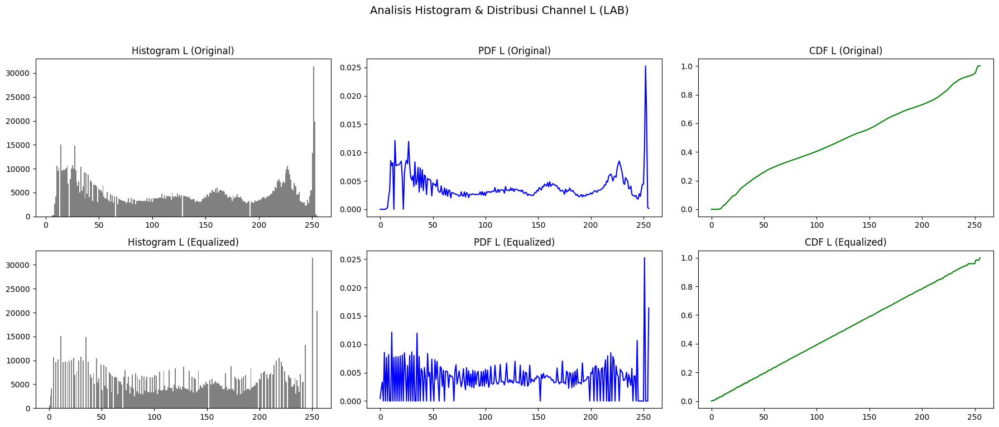

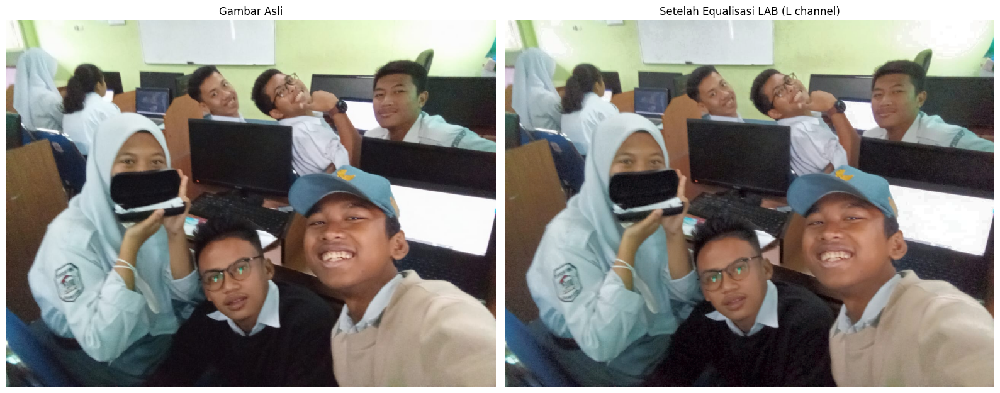

In [7]:
for idx, img_path in enumerate(image_files):
    print(f"\n🎨 Menampilkan hasil LAB Equalization untuk: {os.path.basename(img_path)}")
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Konversi ke LAB dan pisah channel
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    l_orig = l.copy()

    # Equalisasi hanya channel L
    l_eq = cv2.equalizeHist(l)
    lab_eq = cv2.merge([l_eq, a, b])
    img_eq = cv2.cvtColor(lab_eq, cv2.COLOR_LAB2BGR)
    img_eq_rgb = cv2.cvtColor(img_eq, cv2.COLOR_BGR2RGB)

    # ===== Histogram RGB Sebelum & Sesudah =====
    fig_rgb, axs_rgb = plt.subplots(1, 2, figsize=(14, 4))
    colors = ['r', 'g', 'b']
    ch_orig = cv2.split(img_rgb)
    ch_eq = cv2.split(img_eq_rgb)

    for ch, color in zip(ch_orig, colors):
        axs_rgb[0].hist(ch.ravel(), bins=256, color=color, alpha=0.5)
    axs_rgb[0].set_title("Histogram Gabungan RGB (Original)")

    for ch, color in zip(ch_eq, colors):
        axs_rgb[1].hist(ch.ravel(), bins=256, color=color, alpha=0.5)
    axs_rgb[1].set_title("Histogram Gabungan RGB (Setelah Equalisasi LAB)")

    plt.tight_layout()
    plt.show()

    # ===== Histogram, PDF, CDF Channel L =====
    pdf_orig, cdf_orig = calculate_pdf_cdf(l_orig)
    pdf_eq, cdf_eq = calculate_pdf_cdf(l_eq)

    fig_l, axs_l = plt.subplots(2, 3, figsize=(18, 8))
    fig_l.suptitle("Analisis Histogram & Distribusi Channel L (LAB)", fontsize=14)

    axs_l[0, 0].hist(l_orig.ravel(), bins=256, color='gray')
    axs_l[0, 0].set_title("Histogram L (Original)")

    axs_l[0, 1].plot(pdf_orig, color='blue')
    axs_l[0, 1].set_title("PDF L (Original)")

    axs_l[0, 2].plot(cdf_orig, color='green')
    axs_l[0, 2].set_title("CDF L (Original)")

    axs_l[1, 0].hist(l_eq.ravel(), bins=256, color='gray')
    axs_l[1, 0].set_title("Histogram L (Equalized)")

    axs_l[1, 1].plot(pdf_eq, color='blue')
    axs_l[1, 1].set_title("PDF L (Equalized)")

    axs_l[1, 2].plot(cdf_eq, color='green')
    axs_l[1, 2].set_title("CDF L (Equalized)")

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    # ===== Tampilan Gambar =====
    fig_img, axs_img = plt.subplots(1, 2, figsize=(16, 8))
    axs_img[0].imshow(img_rgb)
    axs_img[0].set_title("Gambar Asli")
    axs_img[0].axis('off')

    axs_img[1].imshow(img_eq_rgb)
    axs_img[1].set_title("Setelah Equalisasi LAB (L channel)")
    axs_img[1].axis('off')

    plt.tight_layout()
    plt.show()


## 🌟 Equalisasi Histogram CLAHE pada Channel L (LAB)


CLAHE (Contrast Limited Adaptive Histogram Equalization) adalah teknik peningkatan kontras adaptif yang lebih cerdas dibandingkan dengan histogram equalization biasa. Tujuannya adalah untuk meningkatkan kontras gambar, terutama di bagian-bagian yang lebih gelap atau terang, tanpa menimbulkan efek yang berlebihan pada area yang sudah jelas.

🛠️ Langkah-langkah:

1. Konversi gambar dari BGR ke LAB
2. Pemisahan channel LAB
3. Terapkan CLAHE pada channel L (Lightness)
4. Gabungkan kembali channel LAB
5. Konversi kembali ke ruang warna BGR
6. Bandingkan hasilnya secara visual


✨ Menampilkan hasil CLAHE (LAB) untuk: WhatsApp Image 2025-04-18 at 15.04.31.jpeg


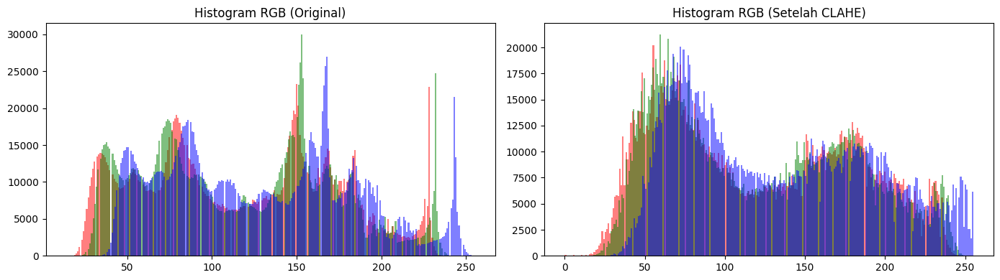

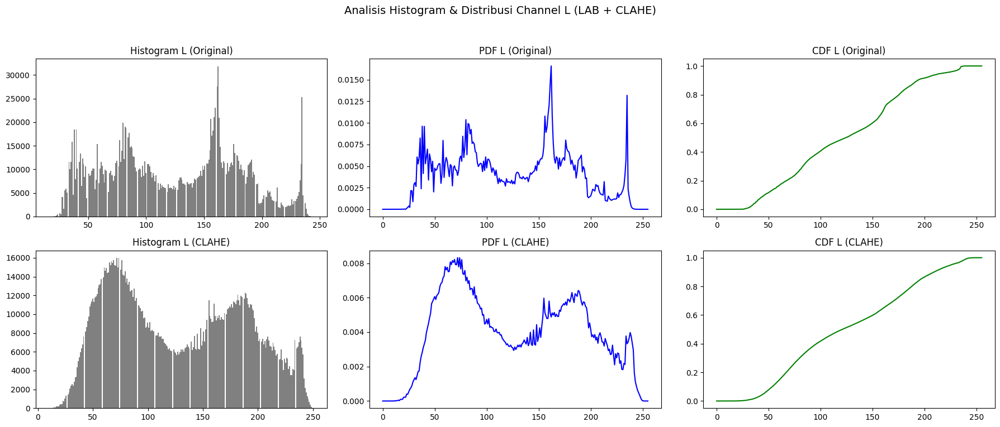

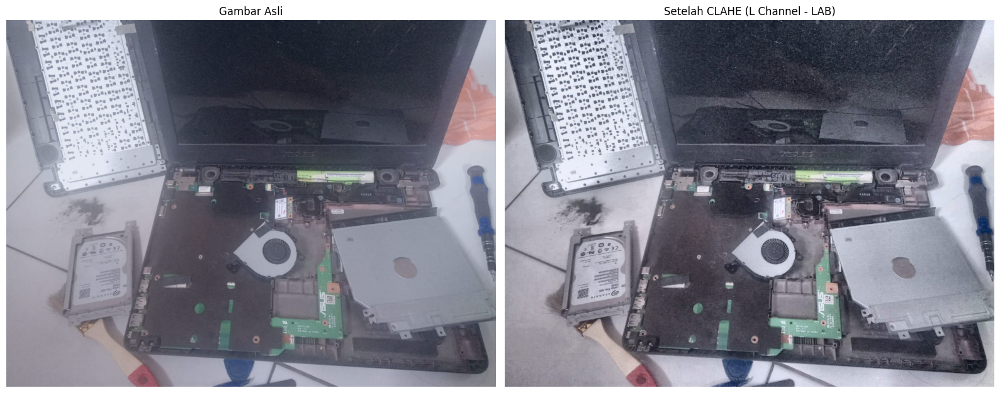


✨ Menampilkan hasil CLAHE (LAB) untuk: WhatsApp Image 2025-04-18 at 15.10.19.jpeg


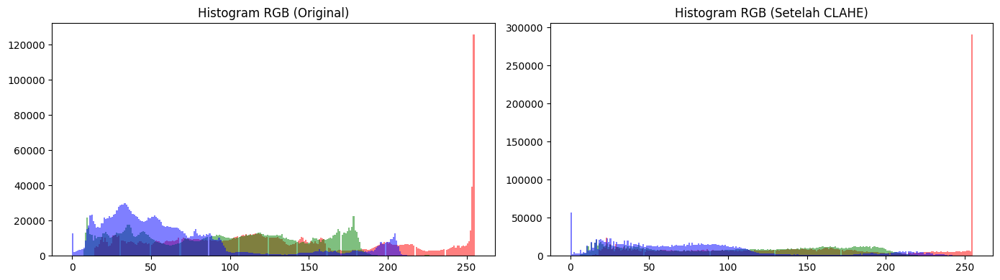

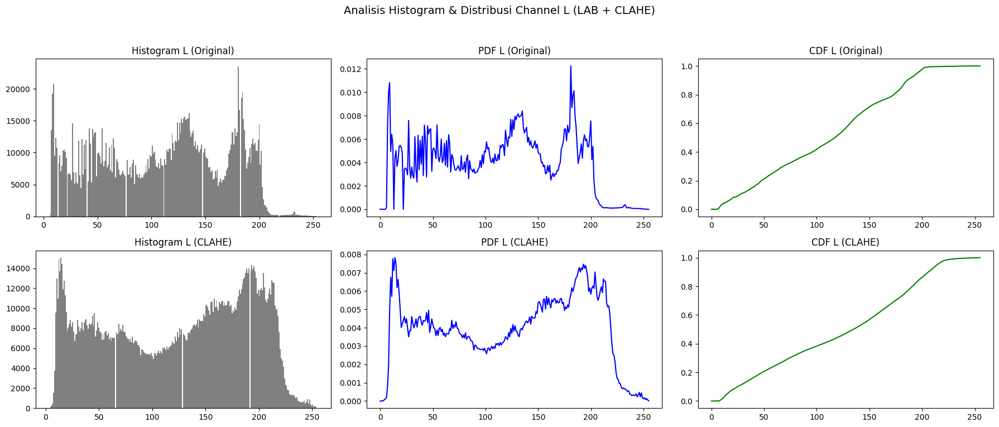

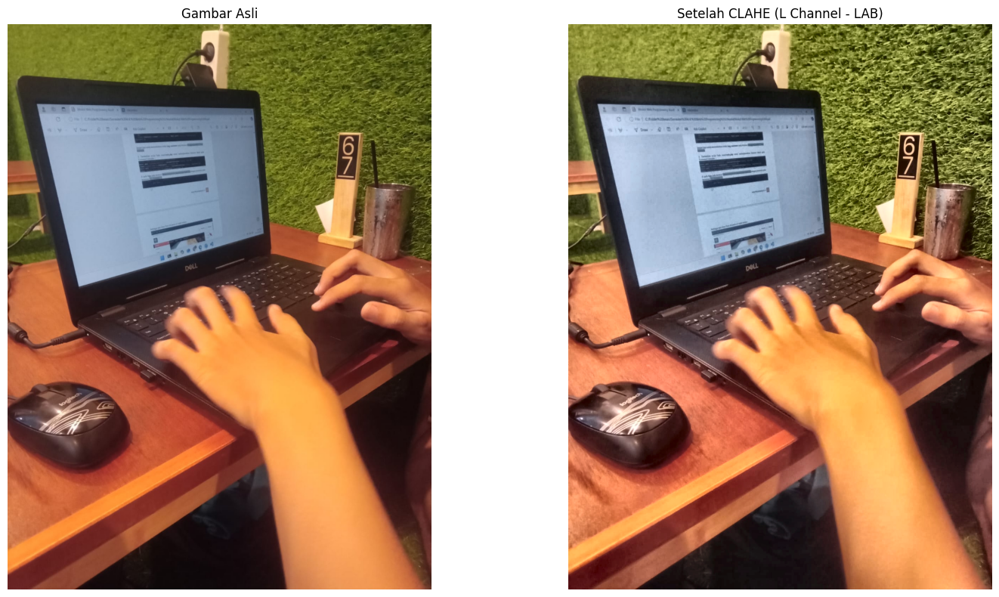


✨ Menampilkan hasil CLAHE (LAB) untuk: WhatsApp Image 2025-04-18 at 15.22.03.jpeg


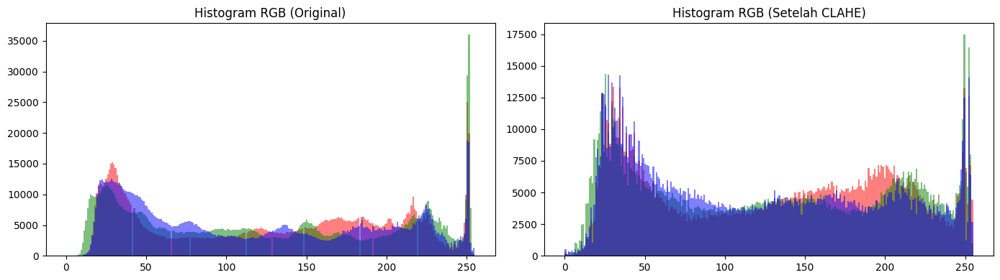

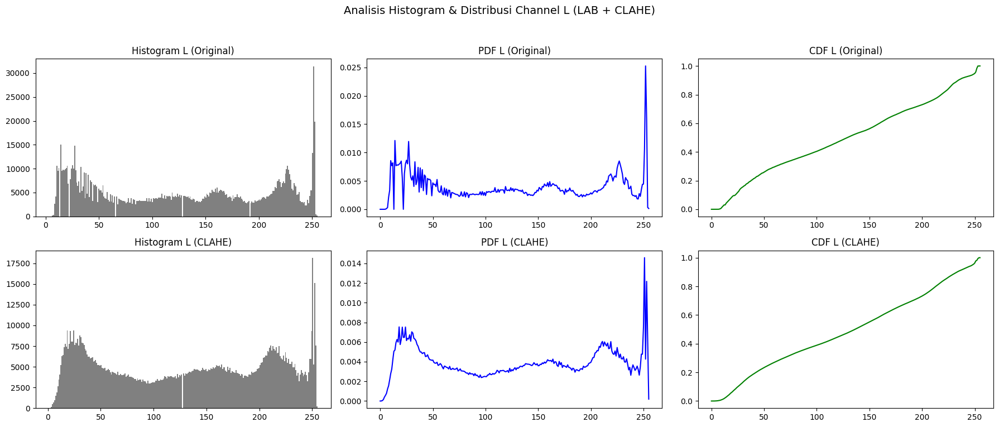

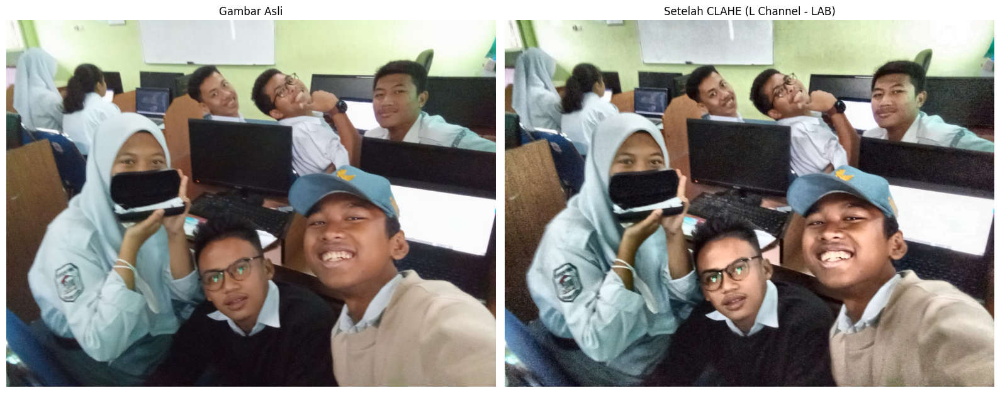

In [8]:
for idx, img_path in enumerate(image_files):
    print(f"\n✨ Menampilkan hasil CLAHE (LAB) untuk: {os.path.basename(img_path)}")
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Konversi ke LAB
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    l_orig = l.copy()

    # Terapkan CLAHE hanya pada channel L
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l_clahe = clahe.apply(l)

    # Gabungkan kembali
    lab_clahe = cv2.merge([l_clahe, a, b])
    img_clahe = cv2.cvtColor(lab_clahe, cv2.COLOR_LAB2BGR)
    img_clahe_rgb = cv2.cvtColor(img_clahe, cv2.COLOR_BGR2RGB)

    # ===== Histogram RGB Sebelum & Sesudah CLAHE =====
    fig_rgb, axs_rgb = plt.subplots(1, 2, figsize=(14, 4))
    colors = ['r', 'g', 'b']
    ch_orig = cv2.split(img_rgb)
    ch_eq = cv2.split(img_clahe_rgb)

    for ch, color in zip(ch_orig, colors):
        axs_rgb[0].hist(ch.ravel(), bins=256, color=color, alpha=0.5)
    axs_rgb[0].set_title("Histogram RGB (Original)")

    for ch, color in zip(ch_eq, colors):
        axs_rgb[1].hist(ch.ravel(), bins=256, color=color, alpha=0.5)
    axs_rgb[1].set_title("Histogram RGB (Setelah CLAHE)")

    plt.tight_layout()
    plt.show()

    # ===== Histogram, PDF, dan CDF untuk L Channel =====
    pdf_orig, cdf_orig = calculate_pdf_cdf(l_orig)
    pdf_clahe, cdf_clahe = calculate_pdf_cdf(l_clahe)

    fig_l, axs_l = plt.subplots(2, 3, figsize=(18, 8))
    fig_l.suptitle("Analisis Histogram & Distribusi Channel L (LAB + CLAHE)", fontsize=14)

    axs_l[0, 0].hist(l_orig.ravel(), bins=256, color='gray')
    axs_l[0, 0].set_title("Histogram L (Original)")

    axs_l[0, 1].plot(pdf_orig, color='blue')
    axs_l[0, 1].set_title("PDF L (Original)")

    axs_l[0, 2].plot(cdf_orig, color='green')
    axs_l[0, 2].set_title("CDF L (Original)")

    axs_l[1, 0].hist(l_clahe.ravel(), bins=256, color='gray')
    axs_l[1, 0].set_title("Histogram L (CLAHE)")

    axs_l[1, 1].plot(pdf_clahe, color='blue')
    axs_l[1, 1].set_title("PDF L (CLAHE)")

    axs_l[1, 2].plot(cdf_clahe, color='green')
    axs_l[1, 2].set_title("CDF L (CLAHE)")

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

    # ===== Gambar Asli vs Hasil CLAHE =====
    fig_img, axs_img = plt.subplots(1, 2, figsize=(16, 8))
    axs_img[0].imshow(img_rgb)
    axs_img[0].set_title("Gambar Asli")
    axs_img[0].axis('off')

    axs_img[1].imshow(img_clahe_rgb)
    axs_img[1].set_title("Setelah CLAHE (L Channel - LAB)")
    axs_img[1].axis('off')

    plt.tight_layout()
    plt.show()

## 📌 Metode Peningkatan Citra Terbaik (LAB + CLAHE + Stretching + Sharpness)







Pada bagian ini, saya akan menerapkan metode peningkatan citra yang komprehensif dengan menggabungkan beberapa teknik untuk mendapatkan hasil optimal:

1. **Konversi ke ruang warna LAB** - Memisahkan informasi luminance (L) dari komponen warna (a,b)
2. **CLAHE (Contrast Limited Adaptive Histogram Equalization)** - Meningkatkan kontras lokal pada channel luminance
3. **Contrast Stretching** - Memaksimalkan rentang dinamis pada channel L yang telah ditingkatkan
4. **Unsharp Masking** - Mempertajam detail pada citra akhir

Metode kombinasi ini sangat efektif karena:
- Ruang warna LAB memisahkan luminance dari informasi warna, memungkinkan peningkatan kontras tanpa mengubah warna
- CLAHE meningkatkan detail lokal dengan lebih baik daripada histogram equalization biasa
- Contrast stretching memaksimalkan dynamic range
- Unsharp masking sebagai langkah terakhir untuk memperjelas detail halus

***Step 1: Konversi RGB ke LAB dan Visualisasi Channel***

Langkah pertama adalah mengubah citra dari ruang warna RGB ke LAB. Ruang warna LAB memisahkan komponen pencahayaan (Lightness/L) dari komponen warna (A dan B), sehingga memungkinkan kita untuk memanipulasi kontras tanpa mempengaruhi warna.

- **Channel L**: Mewakili lightness/luminance (kecerahan) dari 0 (hitam) hingga 255 (putih)
- **Channel A**: Mewakili warna dari hijau (nilai rendah) ke merah (nilai tinggi)
- **Channel B**: Mewakili warna dari biru (nilai rendah) ke kuning (nilai tinggi)

***Step 2: Analisis Histogram Channel L***

Setelah memisahkan channel, saya menganalisis distribusi nilai piksel pada channel L (luminance). Histogram ini akan membantu kita dalam memahami distribusi pencahayaan pada citra dan mengidentifikasi masalah seperti kontras rendah, under-exposure, atau over-exposure.

Dari histogram ini, kita dapat melihat apakah nilai piksel terdistribusi merata atau terkonsentrasi pada rentang tertentu, yang akan menentukan teknik peningkatan citra yang paling efektif.

***Step 3: Penerapan CLAHE pada Channel L***

CLAHE (Contrast Limited Adaptive Histogram Equalization) adalah teknik yang lebih canggih dibandingkan histogram equalization biasa. CLAHE beroperasi pada region kecil (tile) dari citra, dan meningkatkan kontras lokal dengan membatasi amplifikasi untuk menghindari noise.

Parameter penting dalam CLAHE:
- **clipLimit**: Membatasi amplifikasi kontras (nilai 2.0 memberikan peningkatan kontras yang baik tanpa terlalu memperkuat noise)
- **tileGridSize**: Ukuran region/tile untuk perhitungan adaptif (8x8 biasanya memberikan hasil yang baik)

***Step 4: Contrast Stretching pada Channel L***

Setelah menerapkan CLAHE, saya melakukan contrast stretching untuk lebih memaksimalkan dynamic range dari channel L. Teknik ini meningkatkan kontras global dengan "meregangkan" nilai piksel dari rentang yang sempit ke rentang yang lebih lebar.

Saya menggunakan percentile untuk menghindari pengaruh outlier:
- Mengambil nilai percentile ke-2 (p2) sebagai batas bawah
- Mengambil nilai percentile ke-98 (p98) sebagai batas atas
- Meregangkan nilai piksel dalam rentang tersebut untuk mencakup rentang penuh (0-255)

***Step 5: Penggabungan Channel LAB dan Konversi ke RGB***

Setelah melakukan peningkatan pada channel L (luminance), saya menggabungkan kembali dengan channel A dan B yang tidak dimodifikasi. Hal ini memastikan bahwa kita hanya meningkatkan kontras dan detail tanpa mengubah informasi warna pada citra.

Langkah-langkah:
1. Gabungkan kembali L (yang sudah ditingkatkan) dengan A dan B asli
2. Konversi hasil penggabungan dari LAB kembali ke RGB

***Step 6: Unsharp Masking untuk Peningkatan Ketajaman***

Sebagai langkah terakhir, saya menerapkan teknik unsharp masking untuk meningkatkan ketajaman citra. Teknik ini bekerja dengan cara:

1. Membuat versi citra yang diblur (menggunakan Gaussian blur)
2. Mengurangkan versi blur dari citra asli untuk mendapatkan "mask" yang mewakili detail
3. Menambahkan mask ke citra asli dengan bobot tertentu

Formula: Output = Original * (1 + α) - Blur * α

Dalam kode, saya menggunakan cv2.addWeighted dengan bobot 1.3 untuk citra asli dan -0.3 untuk citra blur, yang menghasilkan peningkatan ketajaman yang efektif tanpa menimbulkan artefak berlebihan.

Mari kita lihat hasil akhir dan bandingkan dengan citra original dan citra setelah peningkatan kontras.



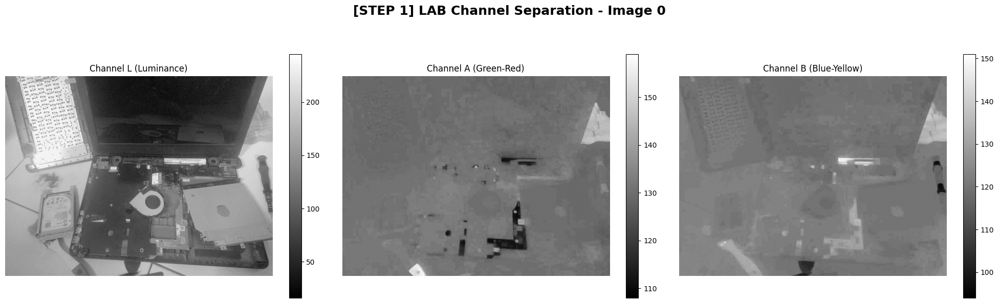

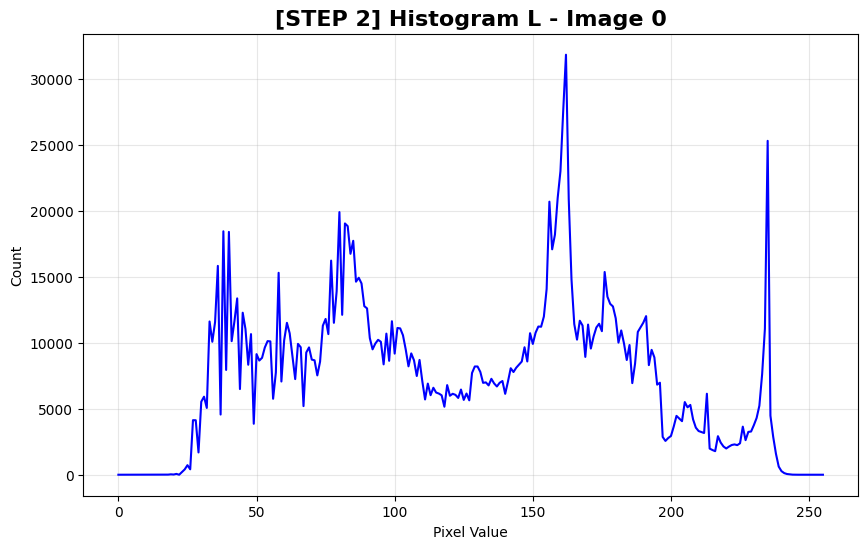

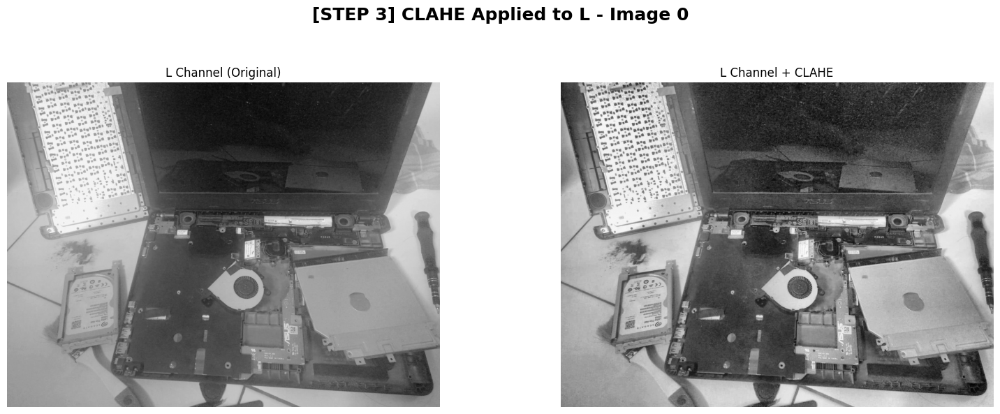

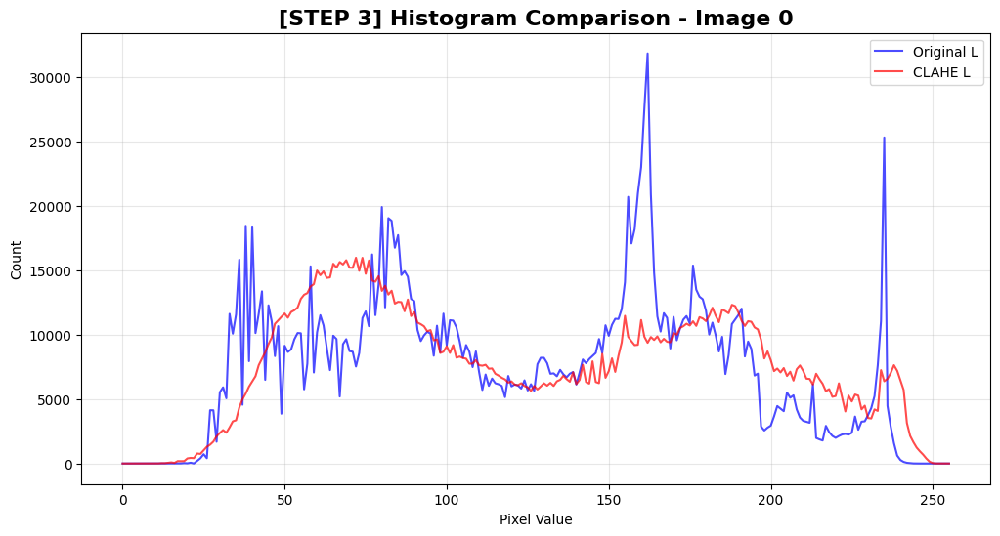

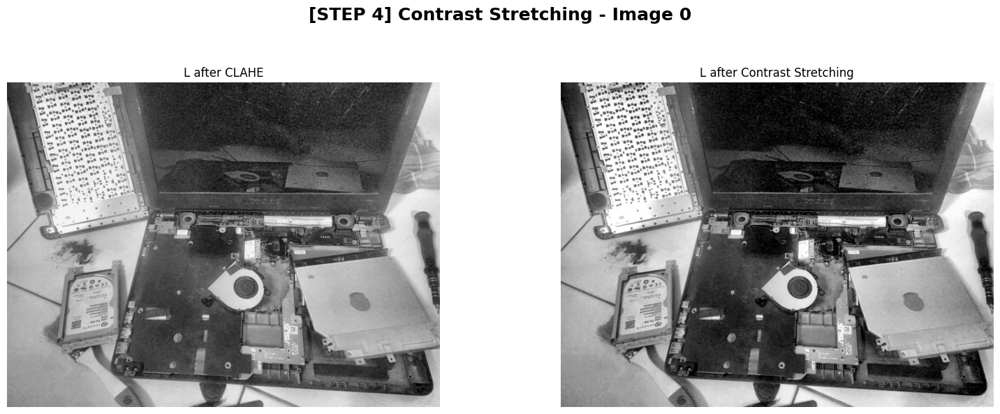

...

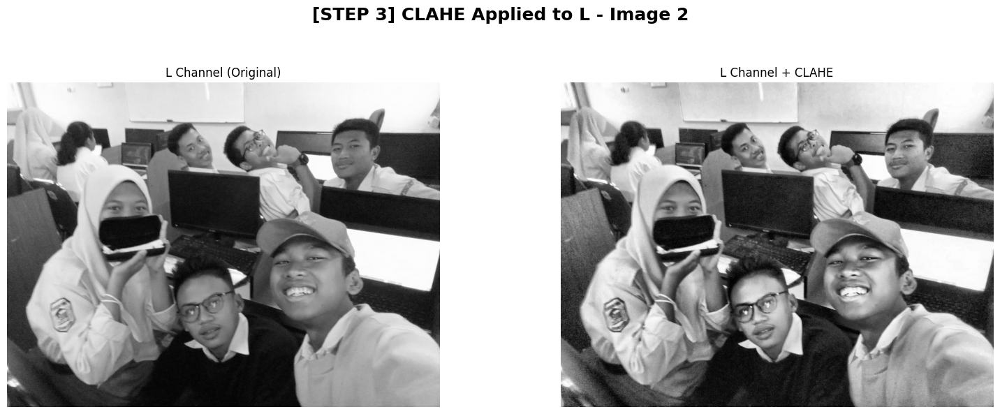

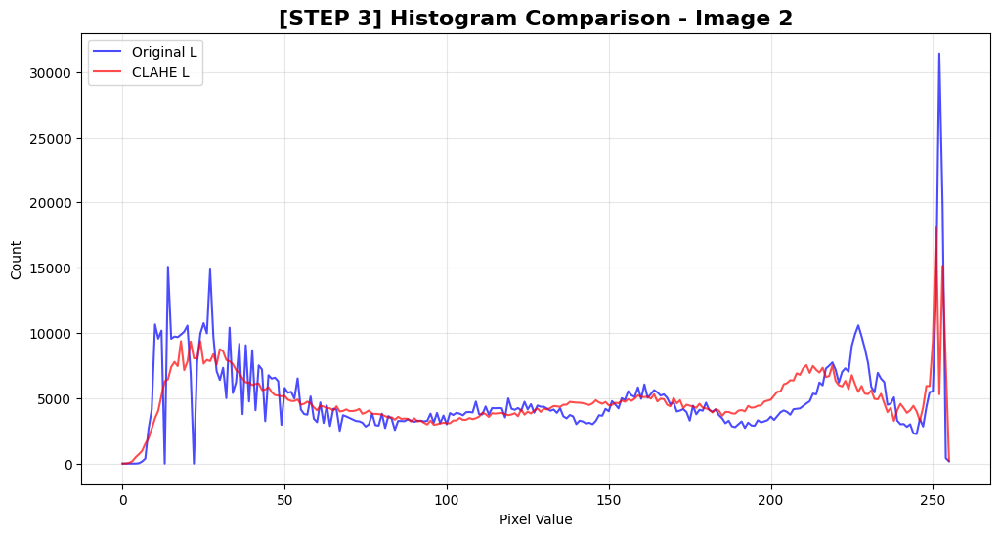

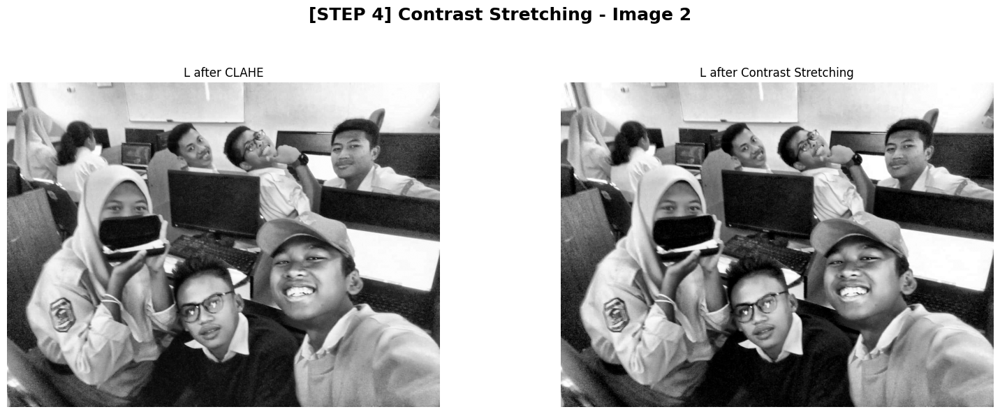

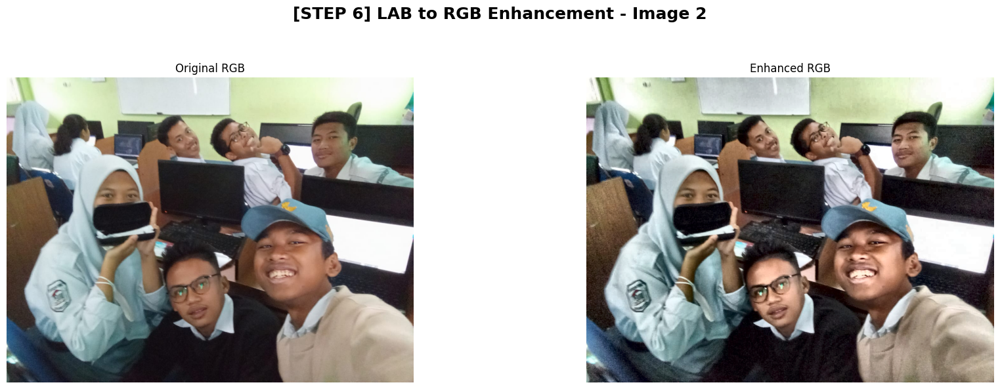

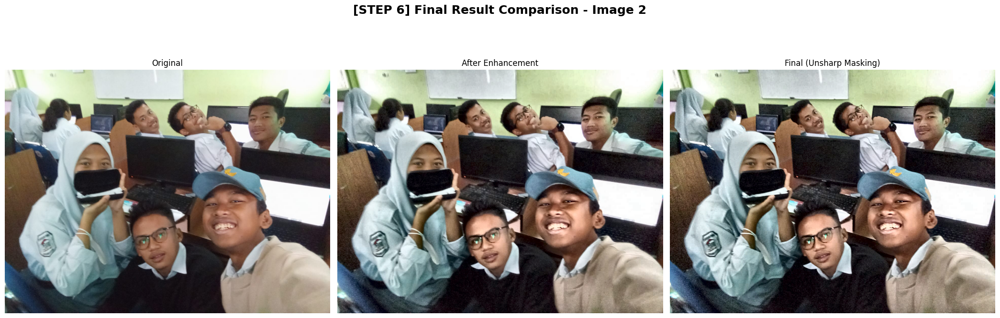

In [14]:
for idx, img_path in enumerate(image_files):
    # --- Load dan konversi ke RGB ---
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # --- STEP 1: Konversi ke LAB dan tampilkan channel ---
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)

    plt.figure(figsize=(20, 6))
    plt.subplot(131)
    plt.imshow(l, cmap='gray')
    plt.title('Channel L (Luminance)')
    plt.colorbar()
    plt.axis('off')

    plt.subplot(132)
    plt.imshow(a, cmap='gray')
    plt.title('Channel A (Green-Red)')
    plt.colorbar()
    plt.axis('off')

    plt.subplot(133)
    plt.imshow(b, cmap='gray')
    plt.title('Channel B (Blue-Yellow)')
    plt.colorbar()
    plt.axis('off')

    plt.suptitle(f"[STEP 1] LAB Channel Separation - Image {idx}", fontsize=18, weight='bold')
    plt.tight_layout()
    plt.subplots_adjust(top=0.82)
    plt.show()

    # --- STEP 2: Histogram dari channel L ---
    hist_l = cv2.calcHist([l], [0], None, [256], [0, 256])

    plt.figure(figsize=(10, 6))
    plt.plot(hist_l, color='blue')
    plt.title(f"[STEP 2] Histogram L - Image {idx}", fontsize=16, weight='bold')
    plt.xlabel('Pixel Value')
    plt.ylabel('Count')
    plt.grid(alpha=0.3)
    plt.show()

    # --- STEP 3: CLAHE ---
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    l_clahe = clahe.apply(l)

    plt.figure(figsize=(16, 6))
    plt.subplot(121)
    plt.imshow(l, cmap='gray')
    plt.title('L Channel (Original)')
    plt.axis('off')

    plt.subplot(122)
    plt.imshow(l_clahe, cmap='gray')
    plt.title('L Channel + CLAHE')
    plt.axis('off')

    plt.suptitle(f"[STEP 3] CLAHE Applied to L - Image {idx}", fontsize=18, weight='bold')
    plt.tight_layout()
    plt.subplots_adjust(top=0.8)
    plt.show()

    # Histogram perbandingan CLAHE
    hist_l_clahe = cv2.calcHist([l_clahe], [0], None, [256], [0, 256])
    plt.figure(figsize=(12, 6))
    plt.plot(hist_l, 'b', alpha=0.7, label='Original L')
    plt.plot(hist_l_clahe, 'r', alpha=0.7, label='CLAHE L')
    plt.title(f"[STEP 3] Histogram Comparison - Image {idx}", fontsize=16, weight='bold')
    plt.xlabel('Pixel Value')
    plt.ylabel('Count')
    plt.legend()
    plt.grid(alpha=0.3)
    plt.show()


    # --- STEP 4: Contrast Stretching ---
    p2, p98 = np.percentile(l_clahe, (2, 98))
    l_stretched = exposure.rescale_intensity(l_clahe, in_range=(p2, p98))

    plt.figure(figsize=(16, 6))
    plt.subplot(121)
    plt.imshow(l_clahe, cmap='gray')
    plt.title('L after CLAHE')
    plt.axis('off')

    plt.subplot(122)
    plt.imshow(l_stretched, cmap='gray')
    plt.title('L after Contrast Stretching')
    plt.axis('off')

    plt.suptitle(f"[STEP 4] Contrast Stretching - Image {idx}", fontsize=18, weight='bold')
    plt.tight_layout()
    plt.subplots_adjust(top=0.8)
    plt.show()

    # --- STEP 5: Gabungkan kembali LAB dan konversi ke RGB ---
    lab_enhanced = cv2.merge([l_stretched.astype(np.uint8), a, b])
    img_enhanced = cv2.cvtColor(lab_enhanced, cv2.COLOR_LAB2BGR)
    img_enhanced_rgb = cv2.cvtColor(img_enhanced, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(18, 6))
    plt.subplot(121)
    plt.imshow(img_rgb)
    plt.title('Original RGB')
    plt.axis('off')

    plt.subplot(122)
    plt.imshow(img_enhanced_rgb)
    plt.title('Enhanced RGB')
    plt.axis('off')

    plt.suptitle(f"[STEP 6] LAB to RGB Enhancement - Image {idx}", fontsize=18, weight='bold')
    plt.tight_layout()
    plt.subplots_adjust(top=0.8)
    plt.show()

    # --- STEP 6: Unsharp Masking ---
    blur = cv2.GaussianBlur(img_enhanced, (0, 0), 3)
    img_sharp = cv2.addWeighted(img_enhanced, 1.3, blur, -0.3, 0)
    img_sharp_rgb = cv2.cvtColor(img_sharp, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(21, 7))
    plt.subplot(131)
    plt.imshow(img_rgb)
    plt.title('Original')
    plt.axis('off')

    plt.subplot(132)
    plt.imshow(img_enhanced_rgb)
    plt.title('After Enhancement')
    plt.axis('off')

    plt.subplot(133)
    plt.imshow(img_sharp_rgb)
    plt.title('Final (Unsharp Masking)')
    plt.axis('off')

    plt.suptitle(f"[STEP 6] Final Result Comparison - Image {idx}", fontsize=18, weight='bold')
    plt.tight_layout()
    plt.subplots_adjust(top=0.82)
    plt.show()

## 🔍Kesimpulan Metode Peningkatan Citra Terbaik


Dari percobaan di atas, kita telah menerapkan pipeline peningkatan citra yang komprehensif dengan menggabungkan:

1. **Ruang warna LAB** - Memungkinkan pemisahan informasi pencahayaan dari warna
2. **CLAHE** - Meningkatkan kontras lokal dengan adaptif
3. **Contrast Stretching** - Memaksimalkan dynamic range
4. **Unsharp Masking** - Mempertajam detail akhir

Beberapa observasi penting:
- Peningkatan detail terlihat jelas pada fitur-fitur penting dalam citra
- Warna tetap alami karena kita hanya memodifikasi channel L
- Metode ini berhasil mengatasi masalah under-exposure dan kontras rendah
- Kombinasi ini memberikan hasil yang lebih baik dibandingkan metode tunggal seperti yang kita lihat pada bagian sebelumnya

Metode ini dapat diterapkan untuk berbagai aplikasi pengolahan citra termasuk medical imaging, fotografi, remote sensing, dan computer vision.

**🤖 Referensi AI**

Analisis dan penjelasan dalam notebook ini dibantu oleh:
- 🟢 **ChatGPT** – Memberikan penjelasan mendalam terkait metode peningkatan citra dan analisis hasil.
- 🔵 **Claude Sonnet** – Membantu dalam pencarian dan eksplorasi kode terkait implementasi teknik peningkatan citra.
